<h1 align='center'> CSE207 </h1>
<h1 align='center'> Notes for Final </h1>

# Learning Flow 10

### How does the net work?
<br>
<div> 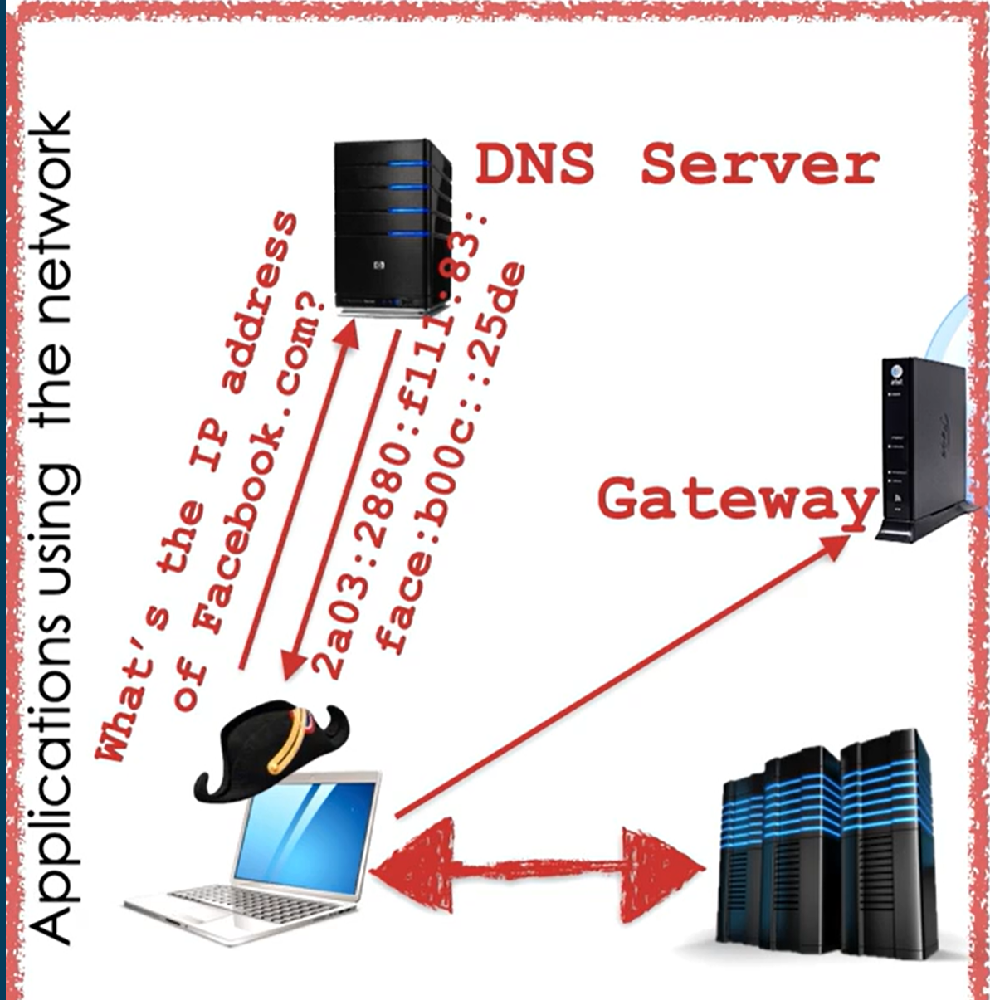 </div>


### How does a computer get its IP address?

**DHCP: Dynamic Host Configuration Protocol**

   - The Computer sends a `broadcast (DHCP Discover)` to annouce its presence on its network (every interface on the same switch/WiFi).
   - If a receiver of the broadcast message is a `DHCP server`, it will send a `DHCP Offer` message to the client back.
   - The DHCP Offer message proposes a
        - A unique `IP Address` for the client
        - `Gateway address` to send IP address requests to
        - List of `DNS Servers` to use in case one is temporarily not available
   - If the client likes the parameters, it sends `DHCP Request` to `DHCP Server` to reserve the parameters for the client.
   - The DHCP replies back with a `DHCP Acknowledgment` message.
    

### How do computers connect to websites?
Computers connect to specific servers located across the world for their corresponding websites using the IP Address of the website 
1.	The client gets the `IP address` of destination from `DNS server`
2.	It checks if the destination is local by comparing the first `64 bits` of the destination IP address 
3.	If destination is not local, then the computer initiaies connection via the `Default Gateway`.
4.  The `Gateway` presumably knows how to deal with the request and does the rest of the job.


# Learning Flow 20

## Basics of Programming in C

### Address layout of a struct in C
<br>
<div> 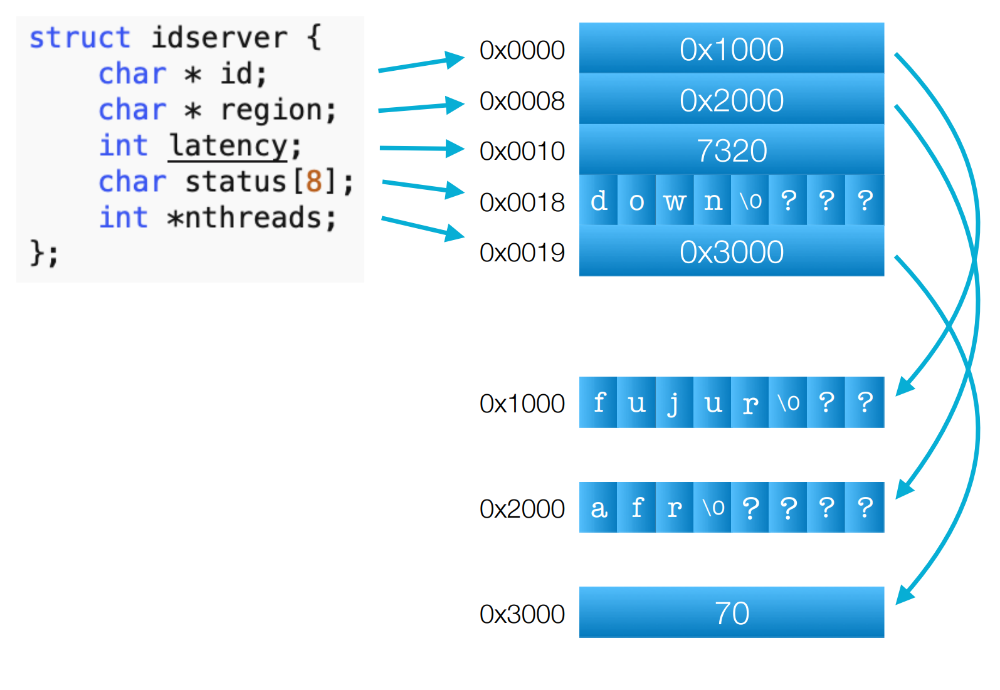 </div>

### Difference between Header and Source files

Technically, the complier  does not make any differences between a source and a header file. However, conventionally, there are huge differences:
- `declarations` of types and functions (prototypes) go into the header files. 
- `definition` (implementation) of the functions and program logic go to source files. They implement the functions declared in the corresponding header files.

### Compiling and Linking

**Compiling** refers to "compile" source code (*.h and *.c) to object (*.o) files. The object files are similar to the machines language. But the object files can't be run directly.
- `cc -c hello-world.c` compiles `hello-world.c` $\to$ `hello-world.o`.

**Linking** refers to creating an executable program from object files.
- `cc -o hello-world hello-world.o` creates an executable file `hello-world`

### Preprocessor Directives
These constitute `small programs` that are run before the compiler is run. They start with `#` and are used to define Macros 
for later use in the C code.

# Learning Flow 30

## Basics of Network Programming

- Connections on the network are between **Hosts** that are placed at `edges` (endpoints).
- **Routers** form the `core` of the network. They are in charge of carrying information between the hosts.

### Types of Communications
1. **Unicast**
    - Exactly one sender, exactly one recepient and both are uniquely identified (IP Address)
    - The communication is universally supported
    - Usually used by TCP and UDP
    - <span font="color:red">IPaddr1:Port1</span> uniquely identifies one process over the entire internet where <span font="color:red">IPaddr1</span> is IP address of sender and <span font="color:red">Port1</span> identifies the process running on the computer. 
    - This pair is called a <span font="color:red">`Socket`</span> and forms the endpoint of all communications
    - Any unique connection is of the form `({TCP|UDP}, IPAddr1, Port1, IPAddr2, Port2)`
    - ex. Web application accessing Web Server


2. **Multicast**
    - Exactly one sender uniquely identified, but mutiple recipients that are named but unknown
    - The recipients have the Multicast Address Ranges from `IPv4: 224.0.0.0 - 239.255.255.255` and `IPv6: ff00::/8`
    - The communication is supported over `LAN (Local Area Network)` and stopped by routers to go any further 
    - Otherwise the entire internet can be spammed and $\downarrow$ in bandwidth
    - ex. DHCP Discover, Chromecast
    

3. **Anycast**
    - One sender uniquely identified, and one recipient that is among a set of unknown recipients
    - Used by data centers to treat high volume of requests by directing them among several servers capable of handling the requests, hence, reducing latency and avoiding service interruptions 
    
### Ports

- Well known Ports for Services (0-1023) can be initiated only by roots
- ex. http:80, smtp:25, nntp:119
- Registered ports (1024, 49152)
- ex. xPilot (15345)


### Connection

1. "Set up" connection
    1. Server "listens" on a port
    2. Client "connects" to server
    3. "Handshake" to negotiate connection parameters depends on Protocol
    - Once connection is set, there is no difference between server and client


2. Transit data back and forth
    - "read" from socket
    - "write" to socket
    
    
3. "Tear down" connection

## Protocol Stack TCP/IP

1. **(Data)Link Layer: `1 hop`**
    - Sends data over the physical layer
    - Adds both footer and header
    - It does not guarantee if the packet is received at the destination
    - Header Element: `Ethertype` (`IPv4='0x800'`, `IPv6='0x86DD'`)
    - ex. Ethernet, WiFi, Token Ring, ATM, Avian carrier
   
   
2. **(Inter)Network(ing) Layer: `Multi-hop`**
    - It decides which interface a package should go through in the routers on the network
    - It tries to select the best interface to send the package on but if it doesnt know then it may drop the packet
    - Also known as the **Convergence Layer**
    - Header Element: `Protocol Number` (`TCP=6`, `UDP=17`)
    - ex. IP


3. **Transport Layer: `end-to-end porperties`**
    - It adds information needed to select which application a packet should be sent to
    - Header Element: `Port Number` for TCP and UDP
    - `Raw IP` skips this layer as it does not need additional headers
    - ex. TCP, UDP


4. **Application Layer: `Application specific`**
    - Adds application information to the packet
    - Chooses transfer protocol to use for the communication and passes it to Transport Layer to add nececssary headers
    - ex. http, smtp


### Original Layout
<br>
<div> 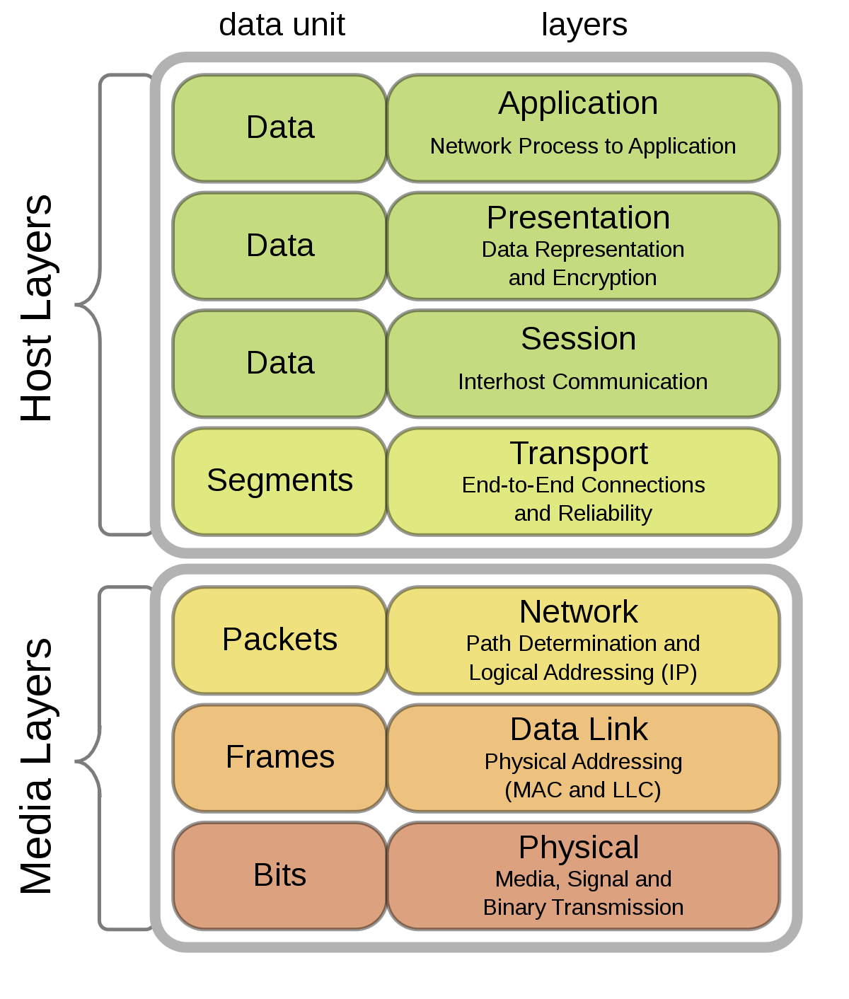 </div>

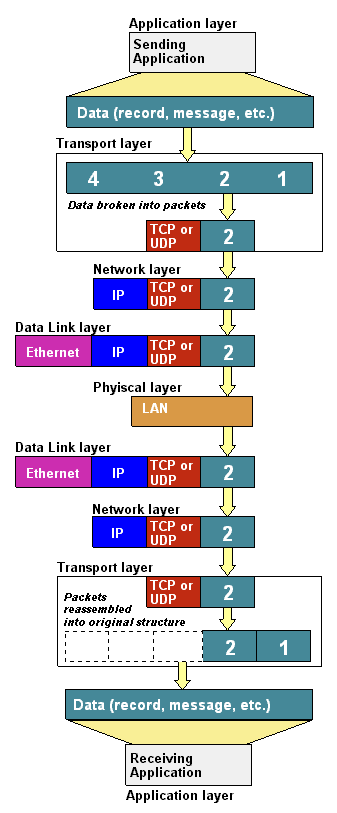

## TCP

1. Mostly widely used protocol with following tranpsort semantics: 
    - A connection-oriented Protocol
    - Present data to receiving application "as they were sent"
    - Preserve ordering, ensure reliability, & integrity    
        - Buffers and timeout for retransmission
        - Sequence numbers (how to enumerate the data)
        - Checksum (integrity)
    - Unicast capable only
    - Best effort: reordering, loss, garbling possible


2. Process of TCP Connection
    - Server "bind" and "listen" to port to accept incoming connection request
    - Client "connects" to server
    - If server is availble, "Handshake" happens (accepts connection request) and connection parameters are negotiated

**Corresponding Server C code is described below.**

<span> 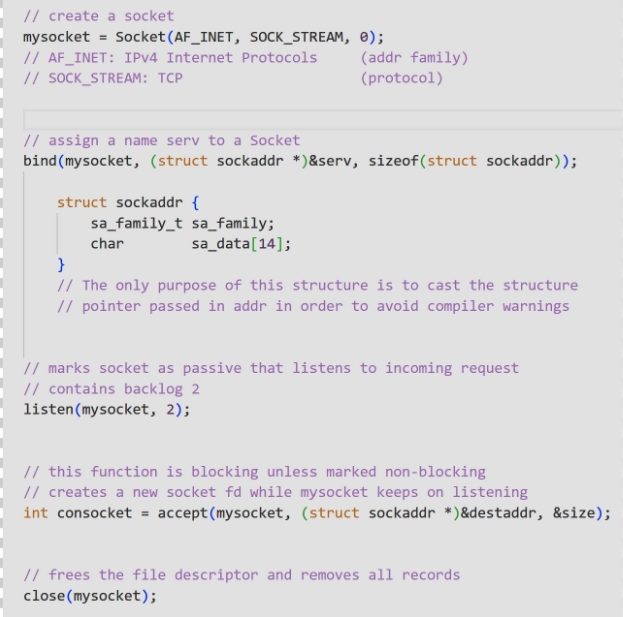 </span>
<span> 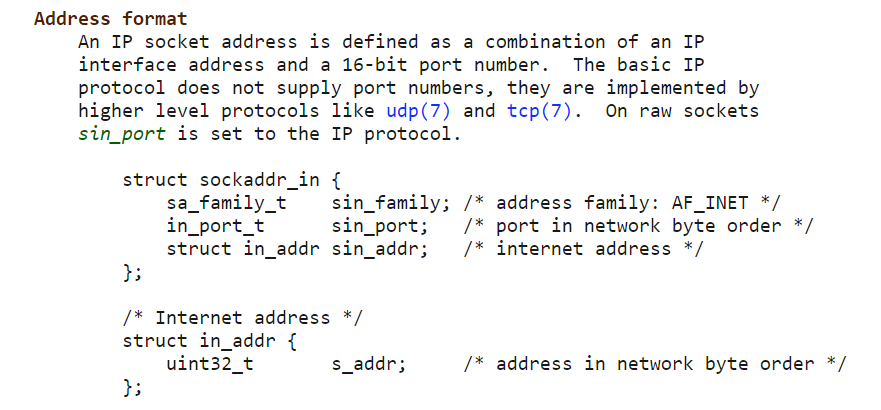 </span>
<br>
<span> 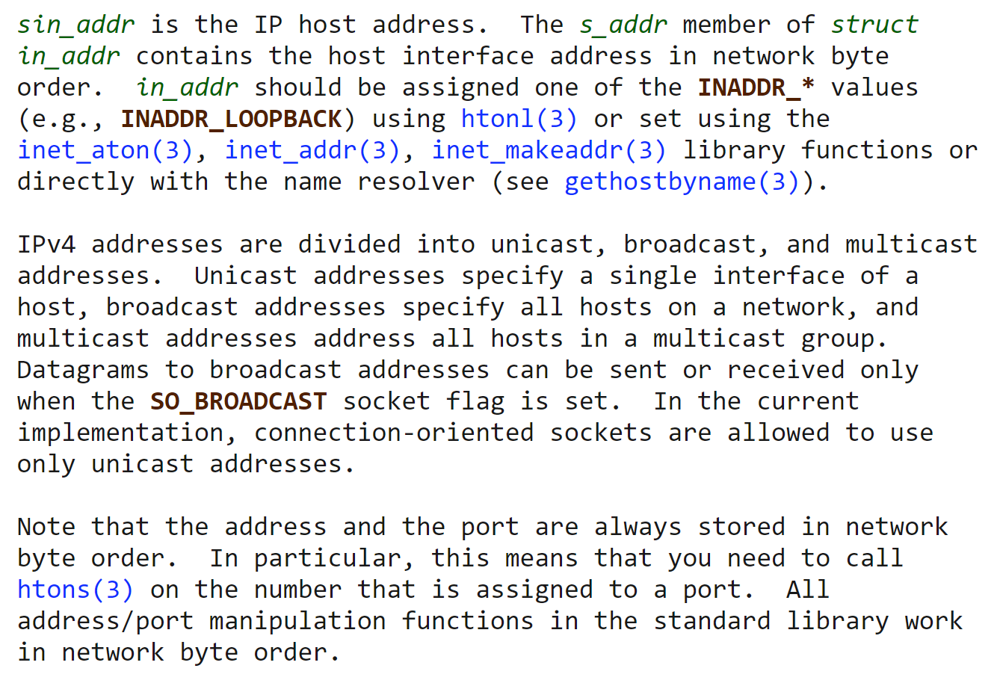 </span>
<span> 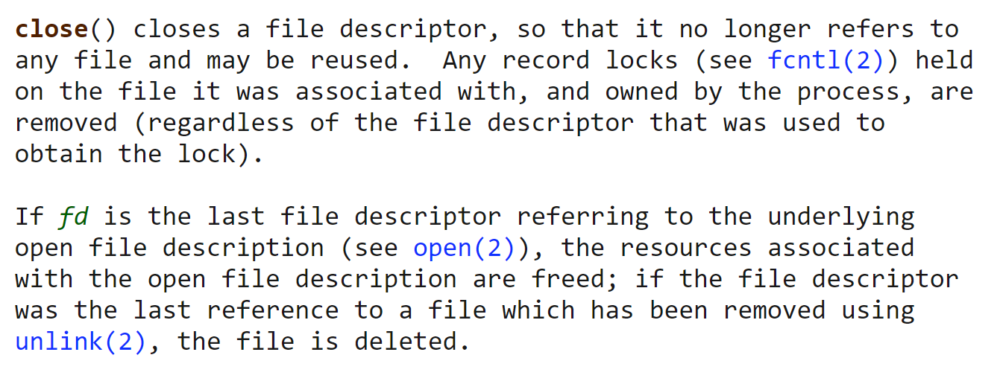 </span>

#### For the Client

<span> 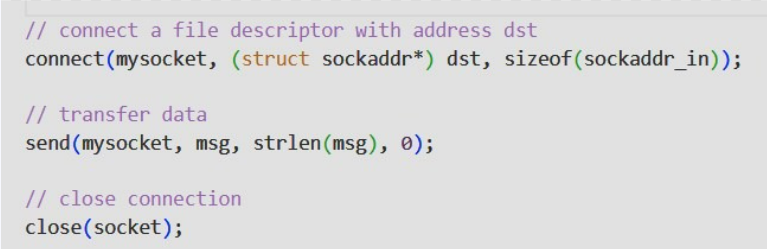 </span>
<span> 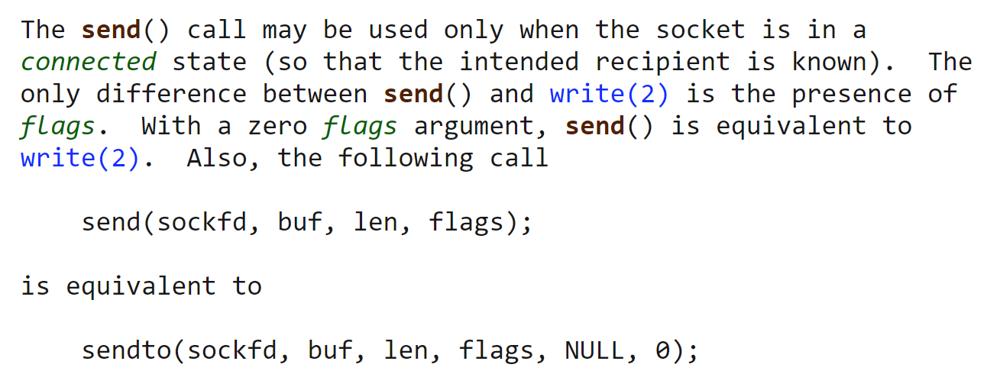 </span>


## UDP

- Service Minimum: It guarantees only integrity of data through **checksums**
- **Multicast capable**, local set-up only
- Best effort: reordering, loss, garbling possible

#### Code for UDP

<span> 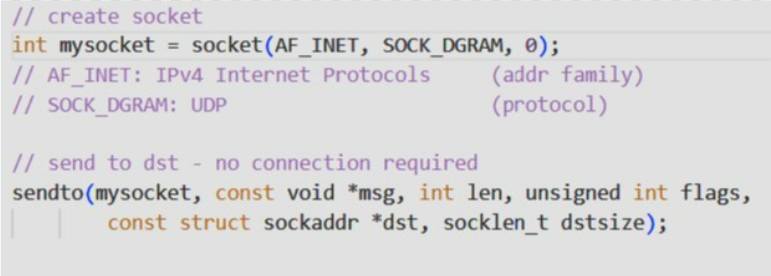 </span>

# Learning Flow 50

## Identifiers

Example Domain Name http://www.example.com:80/filename.html


We need these identifiers to uniquely identify one single resource on the internet and it is used as follows:

- **Fully Qualified Domain Name** (FQDN)
    - www.example.com
- A `DNS lookup` is a request by a client to a `DNS server` to search for IP address of FQDN
- The essential difference between MAC and IP address is 
    - Layer2 vs Layer3 identification 
    - local vs global identification

How Identifiers work:
1. Routers look in `ARP/Neighbor Tables` (IPv4/IPv6) for the corresponding L2 (MAC/Physical/Hardware) address to send the packet to
2. If entry is not in the table, the Router sends **broadcast** (*who-has*) to check where the address is
3. The correct address machine then responds with **Unicast** (*is-at*) message which is added in the Router's `ARP Table`
4. On the way between the Router and the final machine, the **Switch** also updates the L2 address for the corresponding IP address
5. Once the L2 address is correctly found, the packet is sent to that machines `Link Layer` for further resolving.
6. Now the **Ethertype** header in `Link layer` is inspected to send the packet to the corresponding `Network layer`
7. Now the **Protocol Number** in the `Network layer` is inspected to send the packet to the `Transport layer`
8. Then the **Port Number** in the `Transport layer` is inspected to send the packet to the `Application layer`

<br>
<span> 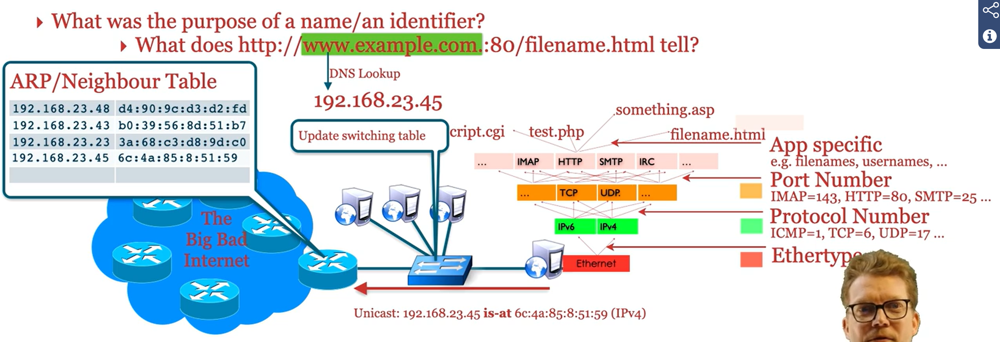 </span>


# Learning Flow 60

## Domain Name System

- DNS is like a distributed database used for:
    - Mapping between "Hostnames" and IP Addresses
    - Abstraction and Redirection
    - Load-Sharing / Load-Balancing
    - Resource-Sharing

- DNS is also an application layer protocol
- DNS uses UDP usually because:
    - No connection set-up
    - No per-query-state
    - No per-client-state

- DNS has is self contained messages which contain either requests, records, or both

Example FQDN that will be used further: www.polytechnique.edu.

### Name Space Organisation + Name Resolution

- The servers across the internet are arranged in a tree like structure with a `root` at the top
- Each server has a **zone file** which keeps the records of all the servers on the next level that can be accessed by it.
- Whenever a new server is added, only the zone file of the server needs to be updated for it to be valid across the internet.
- The **Local DNS** is called `Caching server` because it caches records and also `Recursive Resolver` because it sends the final `IP address` or `error`
- In the process of replying back to any query, the server adds two flags `rd` (recursion desired) || `ra` (recursion available)
- Every `DNS Lookup` is replied back with the following tuple: 

<br>
<div> 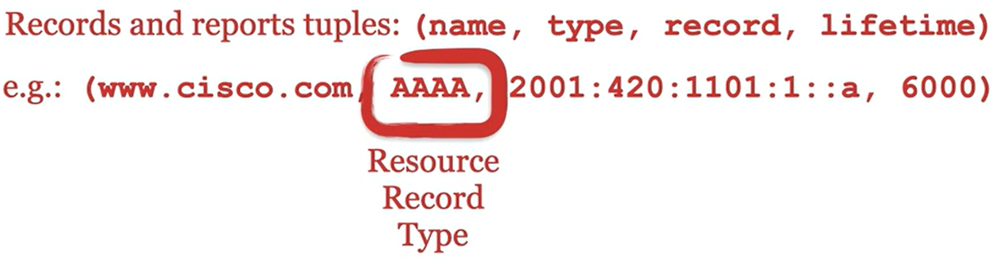 </div>
<br>

How does a DNS Lookup work?
1. An FQDN is send like Client `Stub Resolver` $\to$ `Local DNS` $\to$ `Root server`
2. The `root server` which reads it right $\to$ left, reads `dot` and `edu`. Now, it asks `Local DNS` to look at the `edu` server
3. The `edu` server reads the `dot` and then `polytechnique` so it asks the `Local DNS` to look at `polytechnique` server
4. The `polytechnique` server reads the `dot` and then `www` so it asks the `Local DNS` to look at `www`server
5. Now, the `www` server contains the `IP Address` record for the FQDN which is finally returned and then cached at the `Local DNS` for future reference


<div> 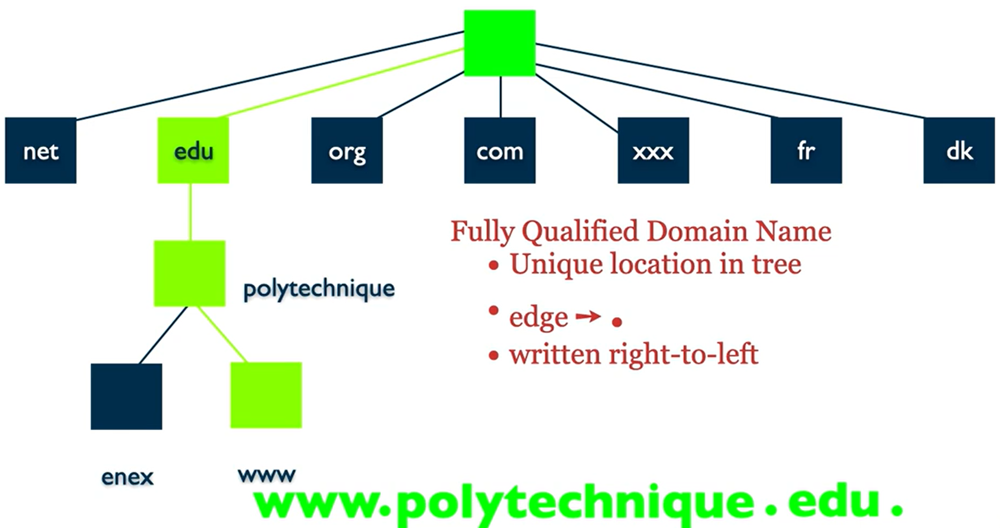 </div>
<br><br>
<span> 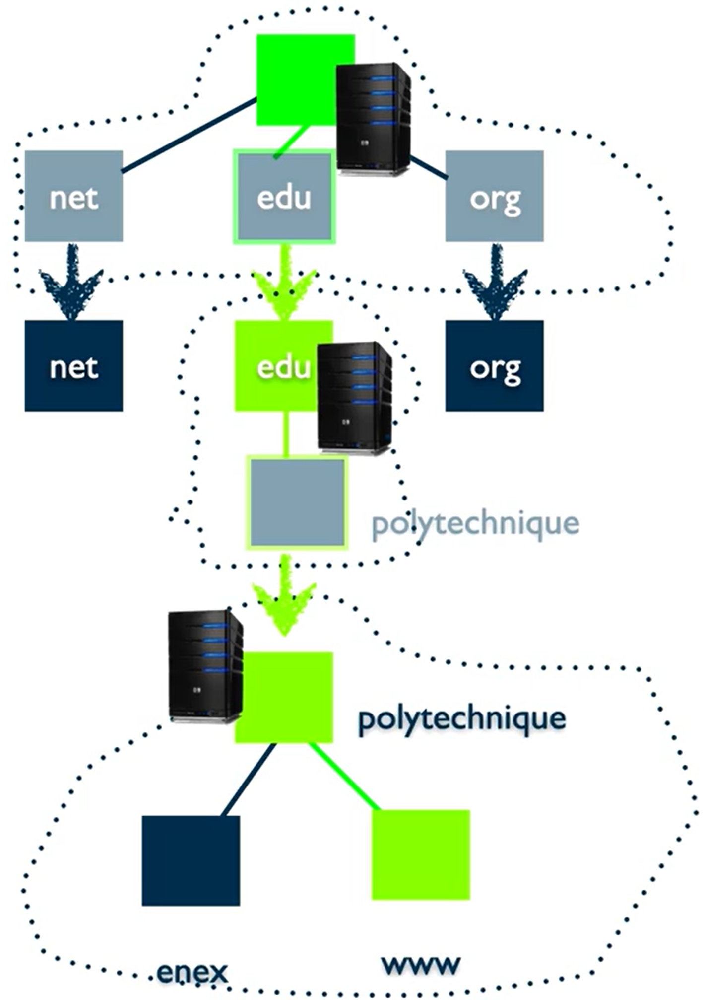 </span>
<span> 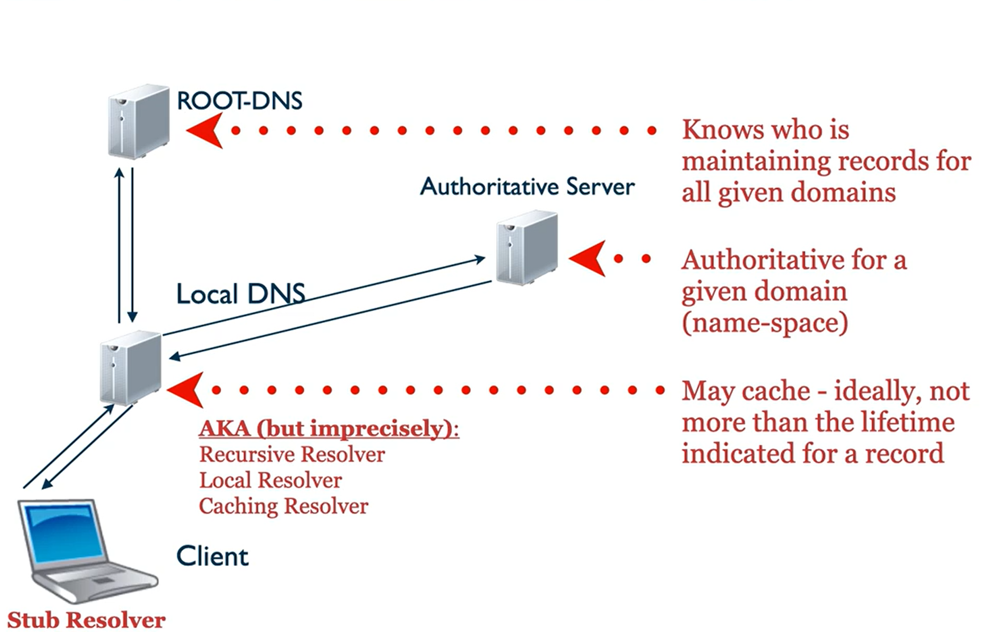 </span>


### RESOURCE RECORDS

In reality, a DNS is a mapping like `(Name, Type)` $\to$ `(Record, Lifetime)`

| Record Type | Name | Value | Return Type |
| :- | :- |:- | :- |
| A | FQDN | IPv4 Address |  `FQDN` $\to$  `IPv4 Address ` |
| AAAA | FQDN | IPv6 Address| `FQDN` $\to$  `IPv6 Address ` |
| CNAME | FQDN | Canonical Name | `FQDN` $\to$  `FQDN ` |
| MX | FQDN | Mailserver | `FQDN` $\to$  `(FQDN, Priority) ` |
| TXT | FQDN | Random Text | `FQDN` $\to$  `Text ` |
| NS | FQDN | Authoritative Name Server |  `FQDN` $\to$  `FQDN ` |

- If there are several mail servers for an MX record, then a server is picked according to the priority field of the available servers. If the server with the lowest priority is available then it is picked otherwise the next one in the hierarchy.
- Sometimes different MX records for domain names map to the same server. This is done purely for human resource organization as the mails are eventually sent to the same server no matter the domain name.

### DNS ROOT

- 13 root server operators
- All are Highly available
- Each root server operator replicates the server all over the world with consistent zone files
- {a-m}.root-servers.net.
- "Bare" DNS server needs to know one (root, other) DNS server only
- To register a FQDN, at least 2 name servers must be available to be Authoritative Servers for it.

# Learning Flow 70



### Routing Tables

- Routers are devices that forward packets to the destination across the network.
- Routing Table consists (example) :
    | Destination | Next Hub | Cost |
    |:-|:-|:-|
    | 130.225.194.2| 129.104.11.1 | 1 |
    | 129.104.11/24 | eth0 | 1 |
    | 101.2.4/24 | 129.104.11.1 | 5 |
    | 0.0.0.0/0 | 87.47.12.254 | 2 |
    | 87.47.12/24 | eth1 | 1 |
    | 87.47.12/24 | eth3 | 2 |
    
    - Addresses in Destination columnn are written in Subnet prefix format
    - The Next column contains two kinds of entries
        - IP Address (next router closer to the given address)
        - Interface (the destination is attached to this interface)
    - 0.0.0.0/0 refers to the default router which connects to all IP addresses over the internet
    
- Each router in the internet contains address of every single destination in the internet
- In each router, the Network(ing) layer has info to help decide which interface the packet should be sent to 
- The router uses routing table to make that decision

#### SUBNET - PREFIX (Netmask)
- Interfaces within the same Subnet prefix have the same IP link (reachable in 1 IP-hop)
<br>
<div> 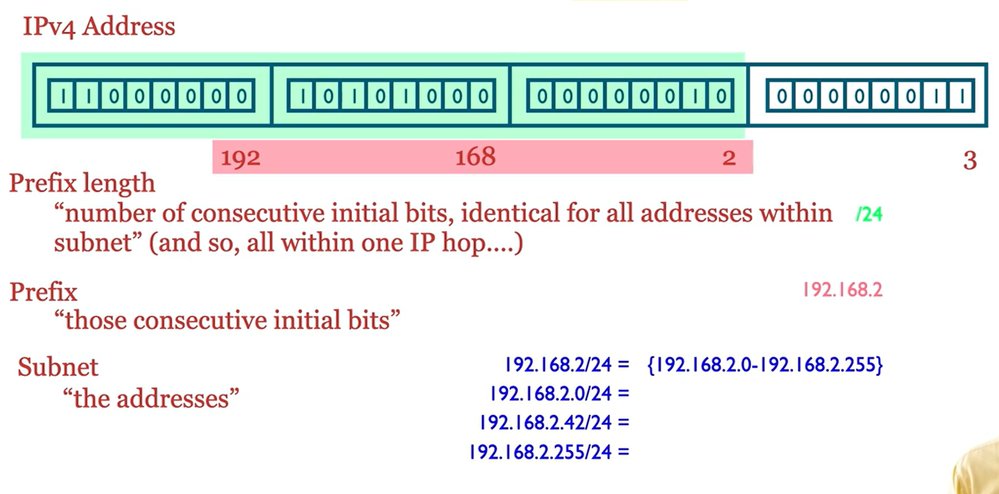 </div>

- Longest Prefix Matching
    - Compare the first x bits of the IP address with the available ones on the routing table
    - If it's a match then the next hub/interface will lead us closer to the destination
    - After comparing all entries, we use the longest prefix match as the next hub
    - If there is a draw then we look at the cheapest cost
    - Once we have the hub, we look for the interface that it is connected to and send the packet over that interface
    - If we can't find the interface with the desired hub, we recursively look for the closest hub with an interface
   

# Learning Flow 80

### THE LOCAL LINK

1. **Network Segment** (Collision Domain):
    - A physical entity through which signal propogates
    - Physics constraints
        - Signal attenuation $\to$ restrict legnth of segment
        - Propogation Delay $\to$ Only 1 transmitter can send signal at a time
    - "Station/Interface" : Physical network interface on the network
    - "Collision Domain" : Any number of interfaces whose signals can collide with each other form a collision domain
    - All stations, hence, compete for exclusive control called Medium Access Control
    

2. **Repeater**:
    - Idea is to connect 2 cables up to max length
    - Then regenerate physical signal and thus extend collission domain

<div> 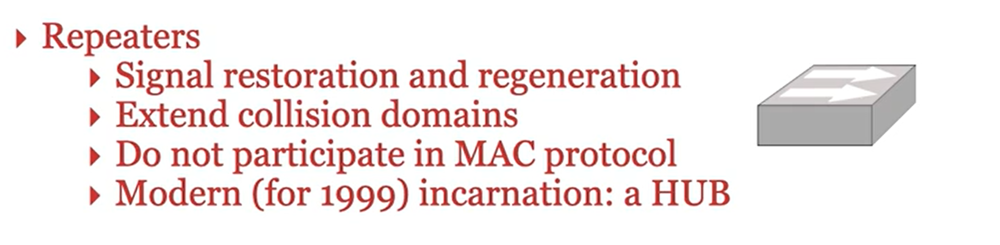 </div>
<br>


3. **Medium Access Control (MAC Protocol)**
    - This protocol provides exclusive access
    - Only 1 station can transmit at a time
    - 
    - Process:
        - *Listen before you transmit*: If channel is busy, back-off
        - *Listen while you transmit*: 
            - If transmission other than own received, backk-off, retry later
            - Otherwise, transmission succeeded HOORAY!
        - To deal with propogation delay, transmitter should listen for 2 * propogation delay
        - Max network segment length $\to$ helps in calculation max propogation delay $\to$ min transmission duration
            - constitutes max number of repeaters
            - For an ethernet network segment it is 4 repeaters, 5 cables

<div> 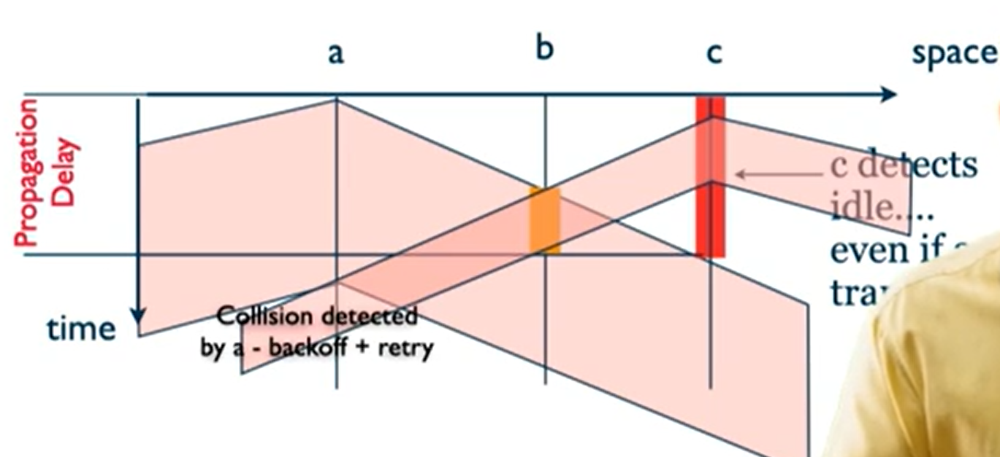 </div>
<br>


4. **Bridge / Ethernet Switch**
    - Connects 2 network segments
        - Creates disjoint "collision domains"
        - Participates in MAC protocol on each interface
        - Decodes received signals into symbols
        - Keep them in queue
        - Attempt to send them with *Listen before/while you transmit*, retransmit if collision
    - Listen to all received frames over all interfaces
        - Record the source address of the frame and the port on which it arrived
        - Record is stored on the bridging table as *<addr, port>*
        - Bridge learns which stations are on which network segments/ports
    - When frame received over port `p_in` with addr a then:
        - If *`<a, p_out>`* does not exist in bridging table, packet is forwarded over all ports except *`p_in`*
        - If *`<a, p_out>`* exists in bridging table then:
            - If `p_out != p_in`, packet is forwarded over the port *`p_out`*
            - If `p_out == p_in`, signal should be dropped because destination *`a`* would have received signal before the switch


5. **Network / Link** (Broadcast Domain):
    - A router connects 2 or more network links
    - A set of interfaces which communicate with each other at L2 for our packets to be forwarded by the router
    - "Broadcast Capable": So that computers can get IP configuration by *DHCP servers* on the *link*
    - "Explicit Connectivity Signals": I have connected/disconnected from the link
    - Components of the link are built to satisfy the previous expectations:
        - Switch
        - Hub
        - WiFi Access Point
    - Each interface has unique identification thanks to L2 (MAC) address

<br>
<div> 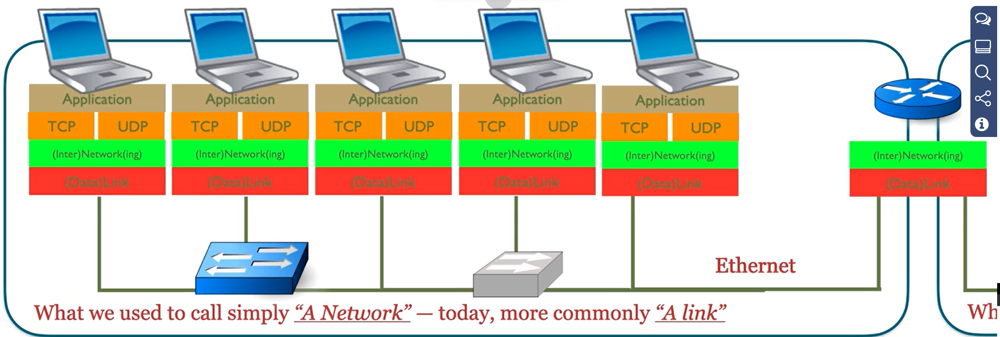 </div>
